In [1]:
!pip install osmnx folium geopy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.5/107.5 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 25.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 79.6 MB/s eta 0:00:00
  Attempting uninstall: networkx
    Found existing installation: networkx 3.4.2
    Uninstalling networkx-3.4.2:
      Successfully uninstalled networkx-3.4.2
  Attempting uninstall: geopandas
    Found existing installation: geopandas 1.0.1
    Uninstalling geopandas-1.0.1:
      Successfully uninstalled geopandas-1.0.1


/usr/local/lib/python3.10/dist-packages/osmnx/graph.py:191: FutureWarning: The expected order of coordinates in `bbox` will change in the v2.0.0 release to `(left, bottom, right, top)`.
  G = graph_from_bbox(


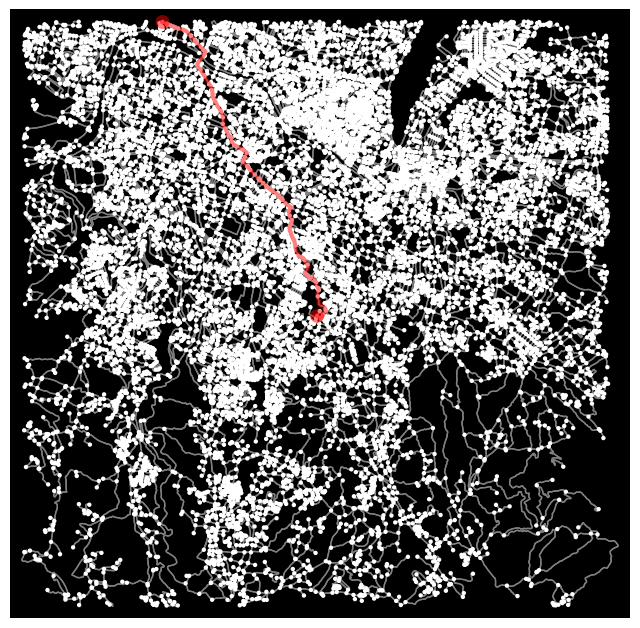

In [2]:
import osmnx as ox
import networkx as nx
import matplotlib.pyplot as plt

origin_coords = (27.650156545284794, 85.3366837896766)
destination_coords = (27.71441775009593, 85.31240423765253)

graph = ox.graph_from_point(origin_coords, dist=5000, network_type="walk")

origin_node = ox.distance.nearest_nodes(graph, origin_coords[1], origin_coords[0])
destination_node = ox.distance.nearest_nodes(graph, destination_coords[1], destination_coords[0])

route = nx.shortest_path(graph, origin_node, destination_node, weight="length")

fig, ax = ox.plot_graph_route(graph, route, route_linewidth=3, node_size=10, bgcolor='k', edge_color='gray')
plt.show()


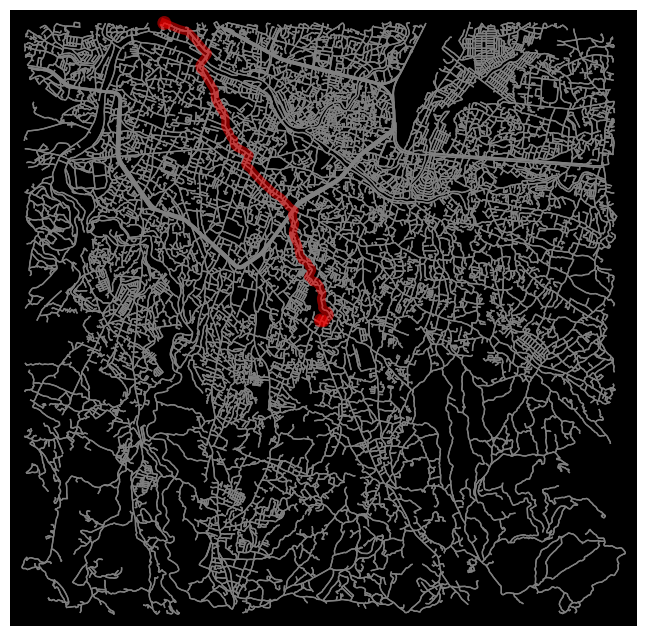

In [7]:

node_coords = [graph.nodes[node] for node in route]
lats = [node['y'] for node in node_coords]
lons = [node['x'] for node in node_coords]

margin = 0.01
north, south = max(lats) + margin, min(lats) - margin
east, west = max(lons) + margin, min(lons) - margin

fig, ax = ox.plot_graph_route(
    graph, route,
    route_linewidth=6,
    node_size=0,
    bgcolor='k',
    edge_color='gray',
    figsize=(12, 8)
)

ax.set_xlim([west, east])
ax.set_ylim([south, north])

plt.show()

<ipython-input-12-e5b6757fd242>:8: FutureWarning: The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  graph = ox.graph_from_bbox(north, south, east, west, network_type="walk")
<ipython-input-12-e5b6757fd242>:8: FutureWarning: The expected order of coordinates in `bbox` will change in the v2.0.0 release to `(left, bottom, right, top)`.
  graph = ox.graph_from_bbox(north, south, east, west, network_type="walk")
<ipython-input-12-e5b6757fd242>:28: FutureWarning: The `get_route_edge_attributes` function has been deprecated and will be removed in the v2.0.0 release. Use the `routing.route_to_gdf` function instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  route1_length = int(sum(ox.utils_graph.get_route_edge_attributes(graph, route1, 'length')))
<ipython-input-12-e5b6757fd242>:29: F

Route 1 (Shortest Distance): 8714 meters, 869 seconds
Route 2 (Shortest Travel Time): 9787 meters, 687 seconds


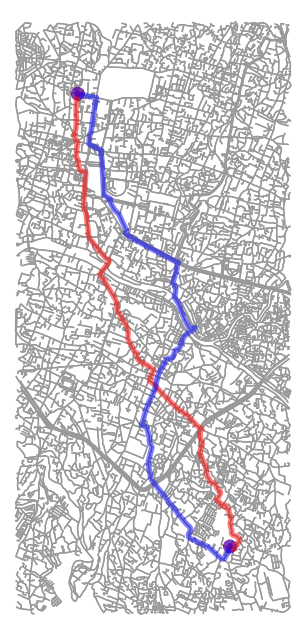

In [12]:
# bounding box to include both points with a margin
north = max(origin_coords[0], destination_coords[0]) + 0.01
south = min(origin_coords[0], destination_coords[0]) - 0.01
east = max(origin_coords[1], destination_coords[1]) + 0.01
west = min(origin_coords[1], destination_coords[1]) - 0.01

#  road network graph for the bounding box
graph = ox.graph_from_bbox(north, south, east, west, network_type="walk")

# peed and travel time to edges
graph = ox.add_edge_speeds(graph)  # Use OSM speed data
graph = ox.add_edge_travel_times(graph)  # Calculate travel time based on speed and length

# default speeds for highway types where maxspeed data is missing
hwy_speeds = {'residential': 35, 'secondary': 50, 'tertiary': 60}
graph = ox.add_edge_speeds(graph, hwy_speeds)
graph = ox.add_edge_travel_times(graph)

# nearest nodes to the origin and destination
origin_node = ox.distance.nearest_nodes(graph, origin_coords[1], origin_coords[0])
destination_node = ox.distance.nearest_nodes(graph, destination_coords[1], destination_coords[0])

# two routes: one minimizing distance, another minimizing travel time
route1 = nx.shortest_path(graph, origin_node, destination_node, weight='length')  # Shortest distance
route2 = nx.shortest_path(graph, origin_node, destination_node, weight='travel_time')  # Shortest time

# route metrics calculation
route1_length = int(sum(ox.utils_graph.get_route_edge_attributes(graph, route1, 'length')))
route2_length = int(sum(ox.utils_graph.get_route_edge_attributes(graph, route2, 'length')))
route1_time = int(sum(ox.utils_graph.get_route_edge_attributes(graph, route1, 'travel_time')))
route2_time = int(sum(ox.utils_graph.get_route_edge_attributes(graph, route2, 'travel_time')))

print(f"Route 1 (Shortest Distance): {route1_length} meters, {route1_time} seconds")
print(f"Route 2 (Shortest Travel Time): {route2_length} meters, {route2_time} seconds")

route_colors = ['r', 'b']  # for distance, Blue for travel time
fig, ax = ox.plot_graph_routes(graph, [route1, route2],
                                route_colors=route_colors,
                                route_linewidth=4,
                                node_size=0,
                                bgcolor='w')

# Show the plot

plt.show()

In [18]:
# Coordinates for origin and destination
origin_coords = (27.650156545284794, 85.3366837896766)
destination_coords = (27.71441775009593, 85.31240423765253)

# bounding box around origin and destination
buffer_dist = 0.005
north = max(origin_coords[0], destination_coords[0]) + buffer_dist
south = min(origin_coords[0], destination_coords[0]) - buffer_dist
east = max(origin_coords[1], destination_coords[1]) + buffer_dist
west = min(origin_coords[1], destination_coords[1]) - buffer_dist

# the graph for the defined bounding box area
graph = ox.graph_from_bbox(north, south, east, west, network_type="walk")

# edge speeds and travel times
graph = ox.add_edge_speeds(graph)
graph = ox.add_edge_travel_times(graph)

# the nearest nodes to origin and destination points
origin_node = ox.distance.nearest_nodes(graph, origin_coords[1], origin_coords[0])
destination_node = ox.distance.nearest_nodes(graph, destination_coords[1], destination_coords[0])

<ipython-input-18-351fbcba76b6>:13: FutureWarning: The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  graph = ox.graph_from_bbox(north, south, east, west, network_type="walk")
<ipython-input-18-351fbcba76b6>:13: FutureWarning: The expected order of coordinates in `bbox` will change in the v2.0.0 release to `(left, bottom, right, top)`.
  graph = ox.graph_from_bbox(north, south, east, west, network_type="walk")


In [19]:
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

route = nx.astar_path(
    graph,
    origin_node,
    destination_node,
    heuristic=lambda u, v: ox.distance.great_circle(graph.nodes[u]['y'], graph.nodes[u]['x'], graph.nodes[v]['y'], graph.nodes[v]['x']),
    weight='travel_time'
)

# coordinates for plotting the route
route_x, route_y = zip(*[(graph.nodes[node]['x'], graph.nodes[node]['y']) for node in route])

# graph and the route
fig, ax = ox.plot_graph(graph, show=False, close=True, edge_color="lightgray")

# show the A* search process
def update(num):
    ax.plot(route_x[:num], route_y[:num], color='red', lw=2)

ani = FuncAnimation(fig, update, frames=len(route), interval=100, repeat=False)


HTML(ani.to_jshtml())

/usr/local/lib/python3.10/dist-packages/matplotlib/animation.py:892: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


In [26]:
!pip freeze > requirements.txt

In [27]:
from google.colab import files
files.download('requirements.txt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>